# EXJOBB 2022 

Data Needed for Evaluation:

• Datum- och tidsstämpel 

• Flöde för värmeöverföringsmediet 

• Inlopps- och utloppstemperatur från solfångarfältet 

• Temperatur vid flödesmätning 

• Vindhastighet 

• Omgivningstemperatur 

• Solinstrålning (pyranometer och pyrheliometer, se Figur 6) 

• Temperaturderivatan – ϑm/dt för varje tidssteg, se (2)1F
4
. Där ϑm är skillnaden i 
medeltemperatur över solfångaren/fältet för det uppmätta tidssteget. 

• Temperatur (och flöde) i varje delkrets för att kunna ta hänsyn till rörförlusterna. 

• Eftersom solfångarna har inbyggd solföljning så behöver också solfångarnas vinkel 
(mot horisontalplanet) mätas och loggas kontinuerligt.

#### Utmaningar/kom ihåg
- Struktur på Notebooken? Hur vill vi att resultat och output ska se ut?
- Hur mycket ska programmet kunna känna av själv (Ex. vilken typ av storhet som mäts baserat på variabelnamn?), och vad ska "hårdkodas"
- Idag kan endast 4 parametrar/csv-fil hämtas ned. Opraktiskt. FIXAT
- Table of content (rubriksättnigar)
- remember to cite PVlib
- table med paketversioner listade

In [1]:
# Import useful packages
import pandas as pd # for tables
import numpy as np # math operations

# Plotting tools
import plotly.express as px
import matplotlib.pyplot as plt

## Steg 1 - Hämta in relevant information i for av csv-filer

Att fundera på:
- Idag finns inget "standariserat sätt" att hämta in data. Jag väljer i Dashboarden vilka kanaler jag vill ladda ned. Idag krashar programmet om jag försöker ta ned för många kanaler samtidigt (när jag försökt ladda ned >6 kanaler under 1 dag med finaste upplösningen). 
- Någonstans behöver det definerras vilka kanaler som krävs för att analys ska kunna genomföras. Errormeddelande om nödvändig kanal fattas? 
- för kategori av kanal, kanske en dict-funktion där alla kanaler från dashboarden redan är definierade, sedan ges kategori i en "if in... then..."

In [36]:
filename='oct13.csv'
filename2='oct13_irradiance.csv'
#Save data as pandas dataframe
df = pd.read_csv(filename).pivot(index = 'Timestamp', columns = 'Channel Name', values = 'Value')
# Merge two frames
df = pd.concat([df, pd.read_csv(filename2).pivot(index = 'Timestamp', columns = 'Channel Name', values = 'Value')], axis=1)
# check for NULL-values (should't be neccisary)
#df = pd.concat([df, pd.read_csv('CSV-files\okt13_angles.csv').pivot(index = 'Timestamp', columns = 'Channel Name', values = 'Value')], axis=1)

if df.isnull().values.any():
    print('Missing values in DataFrame')
    
df

Channel Name,SVS-GT15_TEMPERATURE,SVS_BEAM_RADIATION_1,SVS_BEAM_RADIATION_2,SVS_DIFFUSE_RADIATION_1,SVS_DIFFUSE_RADIATION_2,SVS_HIGHEST_DNI,SVS_MEAN_DNI,SVS_MEAN_GT1,SVS_MEAN_GT3,SVS-GIRD1_IRRADIANCE,SVS-GIRD2_IRRADIANCE,SVS-GIRG1A_IRRADIANCE,SVS-GIRG1B_IRRADIANCE,SVS-GIRG2A_IRRADIANCE,SVS-GIRG2B_IRRADIANCE,r_shading
Timestamp,,,,,,,,,,,,,,,,
2021-10-13 00:00:00,3.1351,0.2904,0.0,0.5198,0.9096,0.0,0.1452,4.2874,28.5,0.4630,0.8102,0.8102,0.4051,0.3798,0.3798,0.0
2021-10-13 00:00:10,3.1279,0.2904,0.0,0.5198,0.9096,0.0,0.1452,4.2845,28.5,0.4630,0.8102,0.8102,0.4051,0.3798,0.3798,0.0
2021-10-13 00:00:20,3.1279,0.3554,0.0,0.4548,0.9096,0.0,0.1777,4.2815,28.5,0.4051,0.8102,0.8102,0.4051,0.3798,0.3798,0.0
2021-10-13 00:00:30,3.1351,0.2904,0.0,0.5198,0.9096,0.0,0.1452,4.2770,28.5,0.4630,0.8102,0.8102,0.4051,0.3798,0.3798,0.0
2021-10-13 00:00:40,3.1243,0.2904,0.0,0.5198,0.9096,0.0,0.1452,4.2748,28.5,0.4630,0.8102,0.8102,0.4051,0.3798,0.3798,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2021-10-13 23:58:20,0.2054,0.5077,0.0,0.6497,0.9096,0.0,0.2538,18.0651,44.3,0.5787,0.8102,1.1574,0.4051,0.4340,0.3798,0.0
2021-10-13 23:58:30,0.1801,0.4498,0.0,0.6497,0.8447,0.0,0.2249,18.0598,44.3,0.5787,0.7523,1.0995,0.4051,0.4340,0.3798,0.0
2021-10-13 23:58:40,0.1910,0.5148,0.0,0.5848,0.9096,0.0,0.2574,18.0501,44.3,0.5208,0.8102,1.0995,0.4051,0.4340,0.3798,0.0


In [3]:
# Types of all variables
for dtype in df.dtypes.iteritems():
    print(dtype)

('SVS-GT15_TEMPERATURE', dtype('float64'))
('SVS_BEAM_RADIATION_1', dtype('float64'))
('SVS_BEAM_RADIATION_2', dtype('float64'))
('SVS_DIFFUSE_RADIATION_1', dtype('float64'))
('SVS_DIFFUSE_RADIATION_2', dtype('float64'))
('SVS_HIGHEST_DNI', dtype('float64'))
('SVS_MEAN_DNI', dtype('float64'))
('SVS_MEAN_GT1', dtype('float64'))
('SVS_MEAN_GT3', dtype('float64'))
('SVS-GIRD1_IRRADIANCE', dtype('float64'))
('SVS-GIRD2_IRRADIANCE', dtype('float64'))
('SVS-GIRG1A_IRRADIANCE', dtype('float64'))
('SVS-GIRG1B_IRRADIANCE', dtype('float64'))
('SVS-GIRG2A_IRRADIANCE', dtype('float64'))
('SVS-GIRG2B_IRRADIANCE', dtype('float64'))


## Step 2 - Visualize data 
(Look at parameters)

Initial verification. 
- Do any values deviate from the expected? 
- Any adjustments or regular maintenance of sensors required? 
- Filtering of raw data needed?



Plot "case plots" as described in ISO (ch. 23).
Might be fitting to consideer useful measurement to conduct for validation of assumptions needed to adopt the theoretical performance model to the conditions at the site.


Tänker att jag kan lägga in lite plottar här. Funderar på om det kan vara enklare att tills vidare ha ett separat dokument för bara plottar, där jag kan ta in och titta på massa data. Ex. jämföra temmp från alla collectors etc.

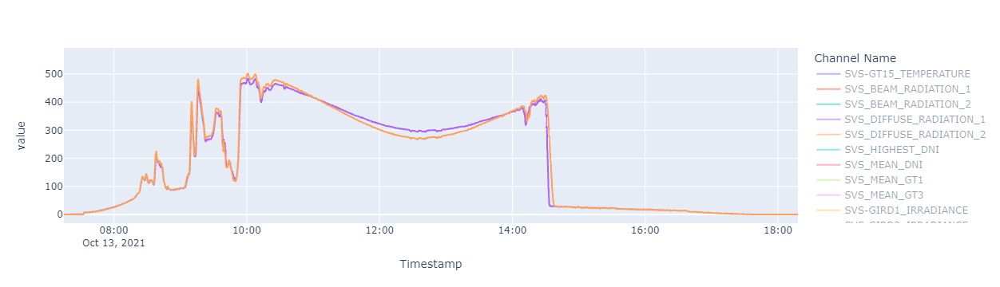

In [4]:
fig = px.line(df, x=df.index, y=df.columns) 
fig.show()

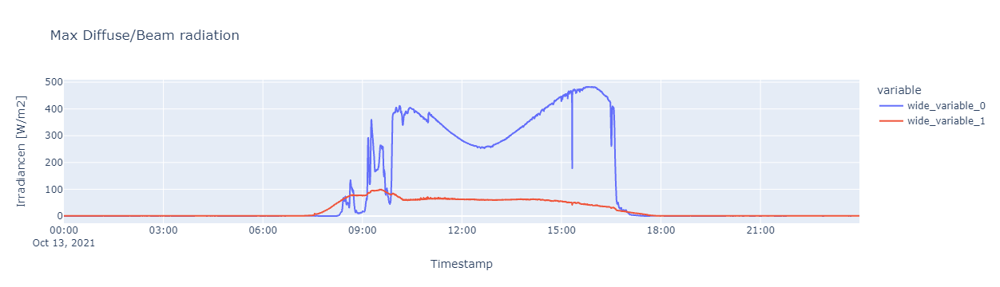

In [5]:
beam_max = df[['SVS_BEAM_RADIATION_1', 'SVS_BEAM_RADIATION_2']].max(axis=1)
diffuse_max = df[['SVS_DIFFUSE_RADIATION_1', 'SVS_DIFFUSE_RADIATION_2']].max(axis=1)
fig = px.line(df, x=df.index, y=[beam_max, diffuse_max],
              labels={"value":"Irradiancen [W/m2]",
                      "wide_variable_0":"Beam Radiation"},
                title="Max Diffuse/Beam radiation")
fig.show()

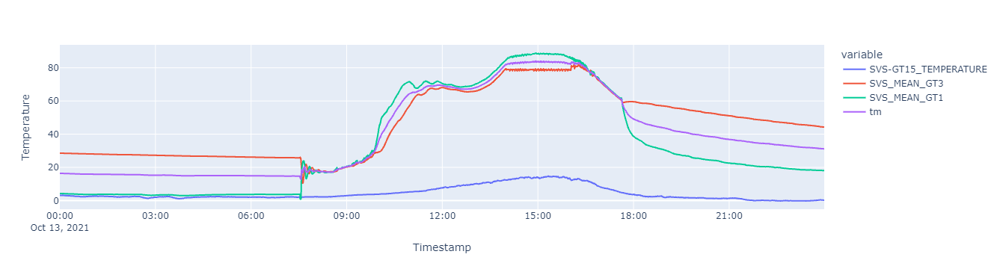

In [6]:
df['tm'] = df[['SVS_MEAN_GT1','SVS_MEAN_GT3']].mean(axis=1)
fig = px.line(df, x=df.index, y=['SVS-GT15_TEMPERATURE','SVS_MEAN_GT3','SVS_MEAN_GT1','tm'],
              labels={'value': 'Temperature','wide_variable_3':'T_m'})
fig.show()

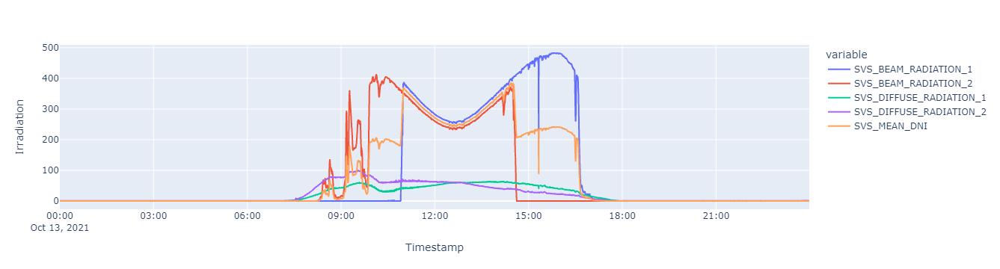

In [7]:
Irradiance = [['SVS_BEAM_RADIATION_1', 'SVS_BEAM_RADIATION_2',
       'SVS_DIFFUSE_RADIATION_1', 'SVS_DIFFUSE_RADIATION_2', 'SVS_MEAN_DNI']]

fig = px.line(df, x=df.index, y=['SVS_BEAM_RADIATION_1', 'SVS_BEAM_RADIATION_2',
       'SVS_DIFFUSE_RADIATION_1', 'SVS_DIFFUSE_RADIATION_2', 'SVS_MEAN_DNI'],
              labels={'value': 'Irradiation'})
fig.show()

In [8]:
df.columns

Index(['SVS-GT15_TEMPERATURE', 'SVS_BEAM_RADIATION_1', 'SVS_BEAM_RADIATION_2',
       'SVS_DIFFUSE_RADIATION_1', 'SVS_DIFFUSE_RADIATION_2', 'SVS_HIGHEST_DNI',
       'SVS_MEAN_DNI', 'SVS_MEAN_GT1', 'SVS_MEAN_GT3', 'SVS-GIRD1_IRRADIANCE',
       'SVS-GIRD2_IRRADIANCE', 'SVS-GIRG1A_IRRADIANCE',
       'SVS-GIRG1B_IRRADIANCE', 'SVS-GIRG2A_IRRADIANCE',
       'SVS-GIRG2B_IRRADIANCE', 'tm'],
      dtype='object', name='Channel Name')

## Step 3 - Implementation of basic model

### Fit data to QDT equation

The extracted power $\dot{Q}$ is in accordance to the quasi dynamic test method for liquid heating collectors modelled as
$$
\dot{Q}=A_{\mathrm{G}}\left[\begin{array}{l} \eta_{0, \mathrm{~b}} K_{\mathrm{b}}\left(\theta_{\mathrm{L}}, \theta_{\mathrm{T}}\right) G_{\mathrm{b}}+\eta_{0, \mathrm{~b}} K_{\mathrm{d}} G_{\mathrm{d}}-a_{1}\left(\vartheta_{\mathrm{m}}-\vartheta_{\mathrm{a}}\right)-a_{2}\left(\vartheta_{\mathrm{m}}-\vartheta_{a}\right)^{2}-a_{3} u^{\prime}\left(\vartheta_{\mathrm{m}}-\vartheta_{\mathrm{a}}\right)+ \\
a_{4}\left(E_{\mathrm{L}}-\sigma T_{\mathrm{a}}^{4}\right)-a_{5}\left(d \vartheta_{\mathrm{m}} / d t\right)-a_{6} u^{\prime} G-a_{7} u^{\prime}\left(E_{\mathrm{L}}-\sigma T_{\mathrm{a}}^{4}\right)-a_{8}\left(\vartheta_{\mathrm{m}}-\vartheta_{\mathrm{a}}\right)^{4}
\end{array}\right].
$$

Parameters as given by the Solar Keymark test for induvidual collectors are given by


|$A_G$|$\eta_{0,b}$|$a_1$|$a_2$|$a_1$|$a_3$|$a_4$|$a_5$|$a_6$|$a_7$|$a_8$|$K_d$|
|---|---|---|---|---|---|---|---|---|---|---|---|
|6.04|0.697|0.73|0.000|0.000|0.000|0.00|0|0.000|0.00|0.00|0.12|


$K_b$, $G_b$, $G_d$, $\vartheta_{\mathrm{m}}, \vartheta_{\mathrm{a}}$ from data stream. Need to calculate $K_{\mathrm{b}}\left(\theta_{\mathrm{L}}, \theta_{\mathrm{T}}\right)$, behöver här en solpositionsperäkning. Behöver alltså theta, dvs. vinkel mot solfångaren i . 

Ta in: Temp in, ut, amb, Gd, Gb, angles?? Eller hur får vi infallsvinkel theta?

Jag behöver en funktion för att få till Kb(thetaL,thetaT) som funktion av tid? 

In [9]:
a1,a2,a3,a4,a5,a6,a7,a8, Kd,etab = 0.73,0.000,0.000,0.00, 0, 0.000, 0.00, 0.00, 0.12,0.697
#Ag = 6.04

#Ag för hela fältet? 1058 m²
Ag = 1058


In [10]:
Kb = 1 # Wrong. Need to account for IAM, BARA HITTEPÅ
# Q_simpleModel = Ag*(etab*Kb*Gb + etab*Kd*Gd -a1*(Tm-Ta) - a2*(Tm-Ta)**2)

In [11]:
def Q(df,diffuse_max,beam_max):
    return Ag*(etab*Kb*beam_max + etab*Kd*diffuse_max-a1*(df['tm']-df['SVS-GT15_TEMPERATURE'])-a2*(df['tm']-df['SVS-GT15_TEMPERATURE'])**2-a5())

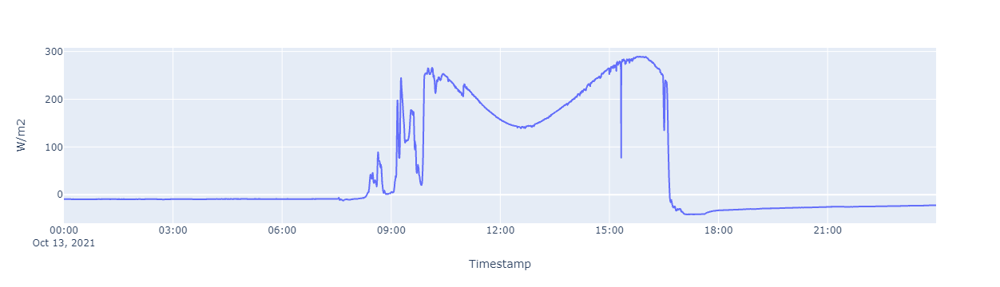

In [12]:
# för Q/m2, let Ag = 1

Q_sqm = (etab*Kb*beam_max + etab*Kd*diffuse_max-a1*(df['tm']-df['SVS-GT15_TEMPERATURE'])-a2*(df['tm']-df['SVS-GT15_TEMPERATURE'])**2)
fig = px.line(df, x=df.index, y=Q_sqm, labels={'y':'W/m2'})
fig.show()

# Har ej tagit hänsyn till IAM & shading

1058

## __Closer look on IAM as given by QDT-method__
(as given by single collector test)

In [2]:
QDT_IAM = [1.00, 0.99, 0.98, 0.96, 0.90, 0.80, 0.64,
           0.43, 0.21, 0.00]
SS_IAM = [1.00, 0.99, 0.99, 0.98, 0.96, 0.91, 0.77, 0.53, 
          0.18, 0.00]
Angles = [0, 10, 20, 30, 40, 50, 60, 70, 80, 90] #zenith angles
IAM_df = pd.DataFrame({#'Angle':Angles,
                       'QDT-method':QDT_IAM,
                      'SS-method':SS_IAM}, index = Angles)

IAM_df.index.names = ['Angle']

IAM_df.T

NameError: name 'pd' is not defined

In [3]:
Angles = IAM_df.index

NameError: name 'IAM_df' is not defined

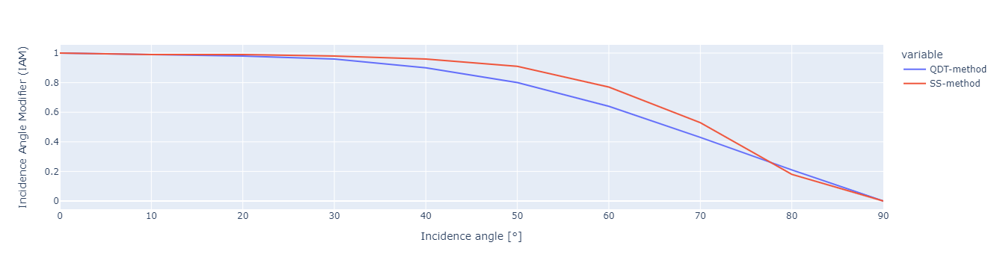

In [79]:
# longitudinal incidence angle modifier from single collector test
fig = px.line(IAM_df,y=['QDT-method','SS-method'], x=IAM_df.index, 
              labels = {'Angle':'Incidence angle [°]','value':'Incidence Angle Modifier (IAM)'})
fig.show()

From polynomial fit below, any angle $\theta$ can be plugged in. (could also just linearize b/w points)

Residual sum of squares for polynomial degree 2 is 0.003395606060606072
Residual sum of squares for polynomial degree 3 is 0.0033368531468531454
Residual sum of squares for polynomial degree 4 is 0.00012674825174825163
Residual sum of squares for polynomial degree 5 is 4.662004662004598e-05


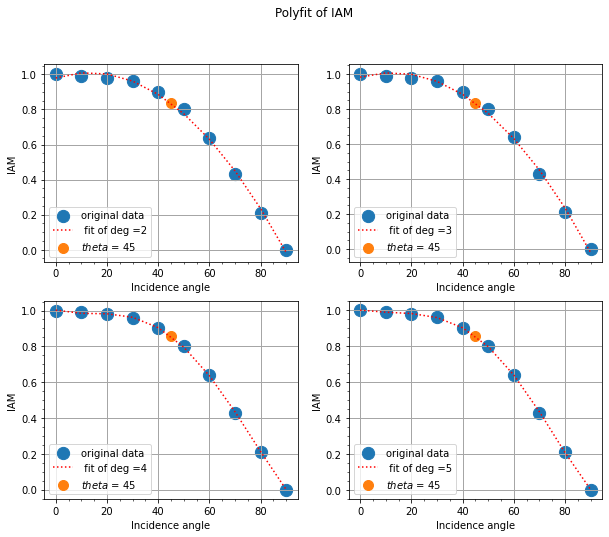

In [81]:
fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(10, 8))# ,sharex=True)
fig.suptitle('Polyfit of IAM')

degrees = np.arange(2,6)
for (deg, ax) in zip(degrees, fig.get_axes()):
    k = np.polyfit(Angles,QDT_IAM,deg)
    #Evaluating New ydata
    IAM = lambda Angles: np.polyval(k,Angles) 

    sum_of_residuals = sum((IAM(Angles) - QDT_IAM)**2)
    print('Residual sum of squares for polynomial degree {0} is {1}'.format(deg, sum_of_residuals))
    
    ax.scatter(Angles,QDT_IAM,150,label='original data')
    ax.plot(Angles,IAM(Angles),'r:',label=' fit of deg ={}'.format(deg))
    
    ax.grid(axis='both',which='major',color=[166/255,166/255,166/255], linestyle='-', linewidth=1)
    ax.minorticks_on()
    ax.scatter(45,IAM(45),100,label='$theta$ = {}'.format(45))
        
    ax.legend(loc=3)
    ax.set_ylabel('IAM')
    ax.set_xlabel('Incidence angle')
    

We use pvlib to get solar position.

In [135]:
from pvlib import solarposition
tz = 'Europe/Stockholm'
lat, lon = 62.6329, 17.938 # degrees. Numbers from Google maps. Are they correct?

times = pd.date_range('2021-10-13 00:00:00', '2021-10-13 23:59:00', freq='10s', tz=tz)

#times = pd.date_range('2019-01-01 00:00:00', '2020-01-01', closed='left',
 #                     freq='H', tz=tz)

solpos = solarposition.get_solarposition(times, lat, lon)
# Let everything above 90deg = 90, for simplification with IAM calculations. (Snyggare att bara definiera om lambda....)
#solpos.loc[solpos['apparent_zenith'] >90,:]['apparent_zenith'] = 90
solpos.loc[solpos['apparent_zenith'] >90,'apparent_zenith'] = 90 #['apparent_zenith'] = 90
solpos

,apparent_zenith,zenith,apparent_elevation,elevation,azimuth,equation_of_time
2021-10-13 00:00:00+02:00,90.0,124.748303,-34.748303,-34.748303,349.559594,13.681299
2021-10-13 00:00:10+02:00,90.0,124.751809,-34.751809,-34.751809,349.609669,13.681327
2021-10-13 00:00:20+02:00,90.0,124.755299,-34.755299,-34.755299,349.659748,13.681355
2021-10-13 00:00:30+02:00,90.0,124.758772,-34.758772,-34.758772,349.709830,13.681383
2021-10-13 00:00:40+02:00,90.0,124.762229,-34.762229,-34.762229,349.759917,13.681411
...,...,...,...,...,...,...
2021-10-13 23:58:20+02:00,90.0,125.089041,-35.089041,-35.089041,349.090853,13.919746
2021-10-13 23:58:30+02:00,90.0,125.092701,-35.092701,-35.092701,349.141073,13.919773
2021-10-13 23:58:40+02:00,90.0,125.096345,-35.096345,-35.096345,349.191298,13.919800
2021-10-13 23:58:50+02:00,90.0,125.099972,-35.099972,-35.099972,349.241527,13.919827


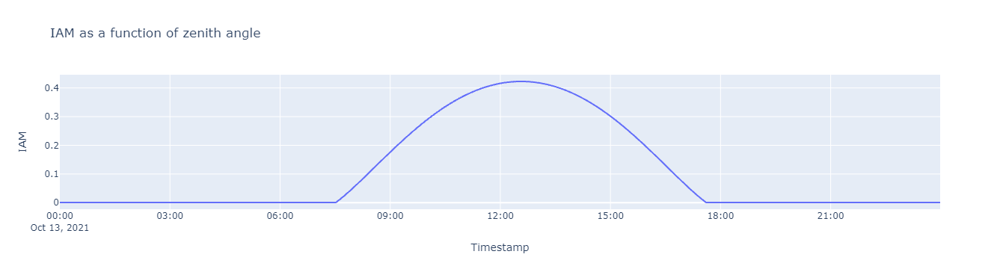

In [156]:
fig = px.line(solpos, x=solpos.index, y=IAM(solpos['apparent_zenith']),
             labels={'y':'IAM','index':'Timestamp'},
             title="IAM as a function of zenith angle")
fig.show()

In [155]:
df.index[350:400] # Eftersläpning i index! På en h har vi en förskjutning på 53 s. 

Index(['2021-10-13 00:58:33', '2021-10-13 00:58:43', '2021-10-13 00:58:53',
       '2021-10-13 00:59:03', '2021-10-13 00:59:13', '2021-10-13 00:59:23',
       '2021-10-13 00:59:33', '2021-10-13 00:59:43', '2021-10-13 00:59:53',
       '2021-10-13 01:00:03', '2021-10-13 01:00:13', '2021-10-13 01:00:23',
       '2021-10-13 01:00:33', '2021-10-13 01:00:43', '2021-10-13 01:00:53',
       '2021-10-13 01:01:03', '2021-10-13 01:01:13', '2021-10-13 01:01:23',
       '2021-10-13 01:01:33', '2021-10-13 01:01:43', '2021-10-13 01:01:53',
       '2021-10-13 01:02:03', '2021-10-13 01:02:13', '2021-10-13 01:02:23',
       '2021-10-13 01:02:33', '2021-10-13 01:02:43', '2021-10-13 01:02:53',
       '2021-10-13 01:03:04', '2021-10-13 01:03:14', '2021-10-13 01:03:24',
       '2021-10-13 01:03:34', '2021-10-13 01:03:44', '2021-10-13 01:03:54',
       '2021-10-13 01:04:04', '2021-10-13 01:04:14', '2021-10-13 01:04:24',
       '2021-10-13 01:04:34', '2021-10-13 01:04:44', '2021-10-13 01:04:54',
       '2021

QDT-model WITH IAM

In [124]:
Kb = IAM(solpos['apparent_zenith'])       
Q = Ag*(etab*Kb*beam_max + etab*Kd*diffuse_max-a1*(df['tm']-df['SVS-GT15_TEMPERATURE'])-a2*(df['tm']-df['SVS-GT15_TEMPERATURE'])**2-a5())

ValueError: operands could not be broadcast together with shapes (8634,) (8604,) 

## Step 4 - Improve performance model 
- Shading effect
- Loss from pipes